Para economizar nos disparos de whatsapp, devemos otimizar os disparos, qualificando se os leads(formulários) resultaram em compras.

Para resolver esse problema utilizando machine learning, devemos buscar fazer uma classificação binária para cada formulário, a qual 0 significa que o formulário não resultou em compra e 1 para formulários que resultaram em compras.

Com base nos atributos do formulário será previsto o disparo da mensagem ou não.

OBS: Um algoritmo perfeito continuaria mandando mensagem para todas pessoas que compram.

## Data collection and preparation

### Data collection

In [2]:
import psycopg2
import pandas as pd

ENDPOINT = 'ec2-3-222-74-92.compute-1.amazonaws.com'
PORT = '5432'
USER = 'zgbodaynfjorzt'
DATABASE = 'dfo2vqe9hs2knm'
PASSWORD = 'd2b11c0c6039df67f39d22f680fb92a843a1b652e3d5b692f6670c0a2abc2804'

engine = psycopg2.connect(
    database=DATABASE,
    user=USER,
    password=PASSWORD,
    host=ENDPOINT,
    port=PORT
)


sql = '''SELECT * FROM forms'''


# lê informações dos formulários
df = pd.read_sql(sql, engine)
df

/usr/local/lib/python3.7/dist-packages/psycopg2/__init__.py:144: UserWarning: The psycopg2 wheel package will be renamed from release 2.8; in order to keep installing from binary please use "pip install psycopg2-binary" instead. For details see: <http://initd.org/psycopg/docs/install.html#binary-install-from-pypi>.
  """)


,id_form,id_cliente,data,sistema_operacional,navegador,localizacao,locale,cidade,estado,qtde_lavagem_semana,...,tipo_fios,procedimentos,tempo_procedimento,dieta,atividade_fisica,frequencia_estresse,caracteristica,faixa_etaria,efeitos_desejados,fragancia
0,c7d453c9c01223a42968d9fe136047,d2620a3e6f00a6dc6e88,2022-01-03 15:42:22,iOS,Safari,"São Paulo, Sao Paulo",BR,SÃO PAULO,SAO PAULO,4,...,Pontas duplas,Nenhum,Há 2 semanas,Celíaca,Frequente,Nunca,Característica 1,25 a 34,Efeito 7,Rosas
1,72830da153824af486be15cd48b3f3,9a48802d8290d19471f3,2022-01-04 08:39:53,Windows,Chrome,"Ribeirão Preto, Sao Paulo",BR,RIBEIRÃO PRETO,SAO PAULO,7,...,Perfeitos,Todos acima,Há mais de 1 mês,Nenhuma restrição,Nunca,Nunca,Característica 6,55 a 64,Efeito 1,Eucalipto
2,d101fc0075dac29db1168cfc61ad44,c3344fad450ee424700d,2022-01-04 19:34:05,Android,Chrome,"São Paulo, Sao Paulo",BR,SÃO PAULO,SAO PAULO,2,...,Rebeldes,Todos acima,Há mais de 1 mês,Nenhuma restrição,Raramente,Regularmente,Característica 7,2 a 10,Efeito 7,Rosas
3,0957fb9d7be36b4d079b6582bb6785,8105e34124e90300d8b5,2022-01-05 18:29:41,Android,Chrome,"Manchester, England",BR,MANCHESTER,ENGLAND,5,...,Rebeldes,Todos acima,Há mais de 1 mês,Celíaca,Raramente,Regularmente,Característica 7,25 a 34,Efeito 7,Rosas
4,ba73bdcc6c063ab08b533eae5505eb,636382f3f545eec3fe97,2022-01-07 11:44:31,Android,Chrome,"Tijucas, Santa Catarina",BR,TIJUCAS,SANTA CATARINA,4,...,Rebeldes,Tintura,Há 1 semana,Celíaca,Sempre,Nunca,Característica 10,18 a 24,Efeito 7,Eucalipto
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
427945,b52c38b852d68ec4b5c8f4fcdf2604,3e0f5c6131151b075a34,2022-02-26 21:28:12,iOS,None,"Santa Barbara, Bahia",BR,SANTA BARBARA,BAHIA,4,...,Rebeldes,Nenhum,Há 1 semana,Nenhuma restrição,Frequente,Uma vez por mês,Característica 7,18 a 24,Efeito 7,Rosas
427946,df3bb506075aa2e212d9a0bf90975d,0266fbc12fe7e7487605,2022-03-03 18:01:43,Windows,Chrome,"Sao Pedro, Sao Paulo",BR,SAO PEDRO,SAO PAULO,1,...,Pontas duplas,Tintura,Há 1 mês,Celíaca,Raramente,Regularmente,Característica 9,65+,"Efeito 7, Efeito 1, Efeito 5",Flores do campo
427947,c172d08a3a36b903cd49f6af8da9c3,b6c0b82cc271fd1203fc,2022-01-27 18:09:34,Windows,Chrome,"Itatiba, Sao Paulo",BR,ITATIBA,SAO PAULO,7,...,Perfeitos,Nenhum,Há mais de 1 mês,Nenhuma restrição,Sempre,Nunca,Característica 6,55 a 64,Efeito 1,Eucalipto
427948,369f40f668082066838beec2861a40,47e6af54dc5898b49ec3,2022-01-27 18:52:16,Android,Chrome,"Arapoti, Parana",BR,ARAPOTI,PARANA,4,...,Pontas duplas,Todos acima,Há mais de 1 mês,Nenhuma restrição,Sempre,Nunca,Característica 8,18 a 24,"Efeito 7, Efeito 1, Efeito 5, Efeito 8",Eucalipto


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 427950 entries, 0 to 427949
Data columns (total 23 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   id_form              427950 non-null  object        
 1   id_cliente           427950 non-null  object        
 2   data                 427950 non-null  datetime64[ns]
 3   sistema_operacional  427950 non-null  object        
 4   navegador            334836 non-null  object        
 5   localizacao          427950 non-null  object        
 6   locale               427950 non-null  object        
 7   cidade               413829 non-null  object        
 8   estado               427752 non-null  object        
 9   qtde_lavagem_semana  427950 non-null  int64         
 10  utm_source           372820 non-null  object        
 11  tipo_cabelo          427950 non-null  object        
 12  comprimento          427950 non-null  object        
 13  tipo_fios     

In [4]:
df.describe()

,qtde_lavagem_semana
count,427950.000000
mean,3.164508
std,1.777032
min,1.000000
25%,1.000000
50%,4.000000
75%,4.000000
max,7.000000


Verificar se o formulário resultou em compra

In [5]:
sql2 = 'SELECT * FROM order_items'

df2 = pd.read_sql(sql2, engine)
df2

,id,id_pedido,id_form,id_produto,qtde,valor
0,423803,dd7dd09eb757eab,62296554a44f818ced0d623434e26b,509d,2,74.95
1,423804,dd7dd09eb757eab,62296554a44f818ced0d623434e26b,e820,1,74.95
2,423805,dd7dd09eb757eab,62296554a44f818ced0d623434e26b,d346,2,59.90
3,423806,dd7dd09eb757eab,62296554a44f818ced0d623434e26b,d2e0,1,64.90
4,423807,46a72a1e08c387e,25e1f26f2ec67b0cbefde74337185a,509d,2,74.95
...,...,...,...,...,...,...
211658,635461,18888fa7d125e97,f6855556b3b8cb4222700aa4291b24,d2e0,1,64.90
211659,635462,18888fa7d125e97,f6855556b3b8cb4222700aa4291b24,509d,1,74.95
211660,635463,5a5622bc254d2bc,21fb2543a1c23bf2604f2e9eb8c800,e820,1,74.95
211661,635464,5a5622bc254d2bc,21fb2543a1c23bf2604f2e9eb8c800,509d,1,74.95


In [6]:
sql3 = 'SELECT * FROM orders'

df3 = pd.read_sql(sql3, engine)
df3

,id_pedido,id_cliente,data_pedido,status_pagamento,tipo_pagamento,valor_total,valor_desconto,frete_gratis,cidade,estado,locale,utm_source
0,c677716e0f2901f,001b7aed7554265e4e5f,2022-03-22 21:10:49,Entregue,CARTÃO,198.63,0.00,True,Osasco,SP,BR,google
1,df063dd3f6b1641,d107878c463e7c969ce6,2022-03-22 21:47:08,Entregue,CARTÃO,198.63,0.00,True,São Paulo,SP,BR,influencer
2,dd69f88884e45a8,44845cf79366dbcecf00,2022-03-08 22:50:22,Entregue,CARTÃO,260.96,0.00,True,Bauru,SP,BR,facebook
3,2c556256ec3a77e,2aa1a61cfa7be6c51167,2022-01-21 14:53:44,Entregue,CARTÃO,225.24,0.00,False,Ananindeua,PA,BR,facebook
4,0262be22fc1c6f0,10c138383539f471831f,2022-03-08 22:50:24,Entregue,CARTÃO,199.31,0.00,True,Saquarema,RJ,BR,facebook
...,...,...,...,...,...,...,...,...,...,...,...,...
55073,efb2662a964fc3f,2b24e80a5c68b1e2beea,2022-05-27 20:49:02,Entregue,CARTÃO,106.59,164.82,True,Barueri,SP,BR,None
55074,eb5927c83f6a8a3,46341dc64e4be47e5a6b,2022-05-31 19:56:57,Em transporte,CARTÃO,93.27,178.55,True,Manaus,AM,BR,None
55075,9e1899f8424623c,c24793059896d1ea37c6,2022-06-02 18:14:21,Pagamento aprovado,CARTÃO,133.23,137.35,True,São Paulo,SP,BR,None
55076,57e2e13e080c377,f36d044ba5ba50335679,2022-06-05 10:27:14,Cancelado,PIX,109.88,164.82,True,Santos,SP,BR,None


### Labeling dataset

In [7]:
df3['status_pagamento'].unique()

array(['Entregue', 'Cancelado', 'Pagamento aprovado', 'Em transporte',
       'Aguardando pagamento', 'Criado'], dtype=object)

Um formulário que gerou uma compra, possui um pedido associado e esse pedido associado deve ter sido efetuado com sucesso. 

In [8]:
df2 = df2.merge(df3[['id_pedido', 'status_pagamento']], left_on='id_pedido', right_on='id_pedido')
df2.drop_duplicates(subset=['id_form'], inplace=True)
df2 = df2[['id_form', 'status_pagamento']]
df2

,id_form,status_pagamento
0,62296554a44f818ced0d623434e26b,Em transporte
4,25e1f26f2ec67b0cbefde74337185a,Cancelado
8,64fbeb0d8b1eab6df76d27df3280ef,Cancelado
12,95138cc338a5ffc3c1bd8169e6a8e3,Em transporte
16,225db060f5ccc01959c5887fa15459,Em transporte
...,...,...
211646,8c417d0c5f076eb1998182c454f2dd,Pagamento aprovado
211649,ecb400f2f38076ab88afff7516f637,Pagamento aprovado
211653,5e0666ba51a3677c416ccfb18a2db9,Pagamento aprovado
211656,f6855556b3b8cb4222700aa4291b24,Pagamento aprovado


In [9]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 54141 entries, 0 to 211660
Data columns (total 2 columns):
 #   Column            Non-Null Count  Dtype 
---  ------            --------------  ----- 
 0   id_form           54141 non-null  object
 1   status_pagamento  54141 non-null  object
dtypes: object(2)
memory usage: 1.2+ MB


In [10]:
df = df.merge(df2, left_on='id_form', right_on='id_form', how='left')
df.head()

,id_form,id_cliente,data,sistema_operacional,navegador,localizacao,locale,cidade,estado,qtde_lavagem_semana,...,procedimentos,tempo_procedimento,dieta,atividade_fisica,frequencia_estresse,caracteristica,faixa_etaria,efeitos_desejados,fragancia,status_pagamento
0,c7d453c9c01223a42968d9fe136047,d2620a3e6f00a6dc6e88,2022-01-03 15:42:22,iOS,Safari,"São Paulo, Sao Paulo",BR,SÃO PAULO,SAO PAULO,4,...,Nenhum,Há 2 semanas,Celíaca,Frequente,Nunca,Característica 1,25 a 34,Efeito 7,Rosas,Entregue
1,72830da153824af486be15cd48b3f3,9a48802d8290d19471f3,2022-01-04 08:39:53,Windows,Chrome,"Ribeirão Preto, Sao Paulo",BR,RIBEIRÃO PRETO,SAO PAULO,7,...,Todos acima,Há mais de 1 mês,Nenhuma restrição,Nunca,Nunca,Característica 6,55 a 64,Efeito 1,Eucalipto,NaN
2,d101fc0075dac29db1168cfc61ad44,c3344fad450ee424700d,2022-01-04 19:34:05,Android,Chrome,"São Paulo, Sao Paulo",BR,SÃO PAULO,SAO PAULO,2,...,Todos acima,Há mais de 1 mês,Nenhuma restrição,Raramente,Regularmente,Característica 7,2 a 10,Efeito 7,Rosas,NaN
3,0957fb9d7be36b4d079b6582bb6785,8105e34124e90300d8b5,2022-01-05 18:29:41,Android,Chrome,"Manchester, England",BR,MANCHESTER,ENGLAND,5,...,Todos acima,Há mais de 1 mês,Celíaca,Raramente,Regularmente,Característica 7,25 a 34,Efeito 7,Rosas,NaN
4,ba73bdcc6c063ab08b533eae5505eb,636382f3f545eec3fe97,2022-01-07 11:44:31,Android,Chrome,"Tijucas, Santa Catarina",BR,TIJUCAS,SANTA CATARINA,4,...,Tintura,Há 1 semana,Celíaca,Sempre,Nunca,Característica 10,18 a 24,Efeito 7,Eucalipto,NaN


In [11]:
print('Quantidade de formulários que não conduziram a uma compra ',df['status_pagamento'].isna().sum())

df['status_pagamento'].value_counts()

Quantidade de formulários que não conduziram a uma compra  373809


Entregue                33275
Pagamento aprovado       9100
Cancelado                8801
Em transporte            2860
Aguardando pagamento      104
Criado                      1
Name: status_pagamento, dtype: int64

Para considerar um formulário que resulte em sucesso, irei considerar apenas as compras em que o pagamento foi aprovado(entregue, pagamento aprovado e em tranporte).

Formulários que não tiveram pedidos e os que tiveram pedidos cancelados seram considerados como sem sucesso.

? Pedidos aguardando pagamento e criados seram descartados. ?

In [12]:
df = df[(df['status_pagamento'] != 'Aguardando pagamento') & (df['status_pagamento'] != 'Criado')]

In [13]:
def compra_sucesso(x):
  if x in ['Entregue', 'Pagamento aprovado', 'Em transporte']:
    return 1
  else:
    return 0

df['sucesso'] = df['status_pagamento'].fillna(0).apply(compra_sucesso)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


In [14]:
df.head()

,id_form,id_cliente,data,sistema_operacional,navegador,localizacao,locale,cidade,estado,qtde_lavagem_semana,...,tempo_procedimento,dieta,atividade_fisica,frequencia_estresse,caracteristica,faixa_etaria,efeitos_desejados,fragancia,status_pagamento,sucesso
0,c7d453c9c01223a42968d9fe136047,d2620a3e6f00a6dc6e88,2022-01-03 15:42:22,iOS,Safari,"São Paulo, Sao Paulo",BR,SÃO PAULO,SAO PAULO,4,...,Há 2 semanas,Celíaca,Frequente,Nunca,Característica 1,25 a 34,Efeito 7,Rosas,Entregue,1
1,72830da153824af486be15cd48b3f3,9a48802d8290d19471f3,2022-01-04 08:39:53,Windows,Chrome,"Ribeirão Preto, Sao Paulo",BR,RIBEIRÃO PRETO,SAO PAULO,7,...,Há mais de 1 mês,Nenhuma restrição,Nunca,Nunca,Característica 6,55 a 64,Efeito 1,Eucalipto,NaN,0
2,d101fc0075dac29db1168cfc61ad44,c3344fad450ee424700d,2022-01-04 19:34:05,Android,Chrome,"São Paulo, Sao Paulo",BR,SÃO PAULO,SAO PAULO,2,...,Há mais de 1 mês,Nenhuma restrição,Raramente,Regularmente,Característica 7,2 a 10,Efeito 7,Rosas,NaN,0
3,0957fb9d7be36b4d079b6582bb6785,8105e34124e90300d8b5,2022-01-05 18:29:41,Android,Chrome,"Manchester, England",BR,MANCHESTER,ENGLAND,5,...,Há mais de 1 mês,Celíaca,Raramente,Regularmente,Característica 7,25 a 34,Efeito 7,Rosas,NaN,0
4,ba73bdcc6c063ab08b533eae5505eb,636382f3f545eec3fe97,2022-01-07 11:44:31,Android,Chrome,"Tijucas, Santa Catarina",BR,TIJUCAS,SANTA CATARINA,4,...,Há 1 semana,Celíaca,Sempre,Nunca,Característica 10,18 a 24,Efeito 7,Eucalipto,NaN,0


## EDA

In [15]:
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt

dados = df.copy()
dados.head()

,id_form,id_cliente,data,sistema_operacional,navegador,localizacao,locale,cidade,estado,qtde_lavagem_semana,...,tempo_procedimento,dieta,atividade_fisica,frequencia_estresse,caracteristica,faixa_etaria,efeitos_desejados,fragancia,status_pagamento,sucesso
0,c7d453c9c01223a42968d9fe136047,d2620a3e6f00a6dc6e88,2022-01-03 15:42:22,iOS,Safari,"São Paulo, Sao Paulo",BR,SÃO PAULO,SAO PAULO,4,...,Há 2 semanas,Celíaca,Frequente,Nunca,Característica 1,25 a 34,Efeito 7,Rosas,Entregue,1
1,72830da153824af486be15cd48b3f3,9a48802d8290d19471f3,2022-01-04 08:39:53,Windows,Chrome,"Ribeirão Preto, Sao Paulo",BR,RIBEIRÃO PRETO,SAO PAULO,7,...,Há mais de 1 mês,Nenhuma restrição,Nunca,Nunca,Característica 6,55 a 64,Efeito 1,Eucalipto,NaN,0
2,d101fc0075dac29db1168cfc61ad44,c3344fad450ee424700d,2022-01-04 19:34:05,Android,Chrome,"São Paulo, Sao Paulo",BR,SÃO PAULO,SAO PAULO,2,...,Há mais de 1 mês,Nenhuma restrição,Raramente,Regularmente,Característica 7,2 a 10,Efeito 7,Rosas,NaN,0
3,0957fb9d7be36b4d079b6582bb6785,8105e34124e90300d8b5,2022-01-05 18:29:41,Android,Chrome,"Manchester, England",BR,MANCHESTER,ENGLAND,5,...,Há mais de 1 mês,Celíaca,Raramente,Regularmente,Característica 7,25 a 34,Efeito 7,Rosas,NaN,0
4,ba73bdcc6c063ab08b533eae5505eb,636382f3f545eec3fe97,2022-01-07 11:44:31,Android,Chrome,"Tijucas, Santa Catarina",BR,TIJUCAS,SANTA CATARINA,4,...,Há 1 semana,Celíaca,Sempre,Nunca,Característica 10,18 a 24,Efeito 7,Eucalipto,NaN,0


In [16]:
dados.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 427845 entries, 0 to 427949
Data columns (total 25 columns):
 #   Column               Non-Null Count   Dtype         
---  ------               --------------   -----         
 0   id_form              427845 non-null  object        
 1   id_cliente           427845 non-null  object        
 2   data                 427845 non-null  datetime64[ns]
 3   sistema_operacional  427845 non-null  object        
 4   navegador            334754 non-null  object        
 5   localizacao          427845 non-null  object        
 6   locale               427845 non-null  object        
 7   cidade               413726 non-null  object        
 8   estado               427647 non-null  object        
 9   qtde_lavagem_semana  427845 non-null  int64         
 10  utm_source           372742 non-null  object        
 11  tipo_cabelo          427845 non-null  object        
 12  comprimento          427845 non-null  object        
 13  tipo_fios     

Como as features para o algoritmo, resolvi utilizar todas que tivessem alguma relação com o cabelo.

In [17]:
# dropando colunas que não fazem sentindo ter relação com o sucesso da compra
# cidade e estado influenciam?

cols = ['id_form', 'id_cliente', 'data', 'sistema_operacional', 'navegador', 
        'locale', 'localizacao', 'utm_source', 'status_pagamento', 'cidade',
        'estado']

dados = dados.drop(columns=cols)

dados.head()

,qtde_lavagem_semana,tipo_cabelo,comprimento,tipo_fios,procedimentos,tempo_procedimento,dieta,atividade_fisica,frequencia_estresse,caracteristica,faixa_etaria,efeitos_desejados,fragancia,sucesso
0,4,Tipo 2,Raíz exposta,Pontas duplas,Nenhum,Há 2 semanas,Celíaca,Frequente,Nunca,Característica 1,25 a 34,Efeito 7,Rosas,1
1,7,Tipo 4,Muito curto,Perfeitos,Todos acima,Há mais de 1 mês,Nenhuma restrição,Nunca,Nunca,Característica 6,55 a 64,Efeito 1,Eucalipto,0
2,2,Tipo 1,Extra longo,Rebeldes,Todos acima,Há mais de 1 mês,Nenhuma restrição,Raramente,Regularmente,Característica 7,2 a 10,Efeito 7,Rosas,0
3,5,Tipo 1,Extra longo,Rebeldes,Todos acima,Há mais de 1 mês,Celíaca,Raramente,Regularmente,Característica 7,25 a 34,Efeito 7,Rosas,0
4,4,Tipo 3,Muito curto,Rebeldes,Tintura,Há 1 semana,Celíaca,Sempre,Nunca,Característica 10,18 a 24,Efeito 7,Eucalipto,0


In [18]:
dados.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 427845 entries, 0 to 427949
Data columns (total 14 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   qtde_lavagem_semana  427845 non-null  int64 
 1   tipo_cabelo          427845 non-null  object
 2   comprimento          427845 non-null  object
 3   tipo_fios            427845 non-null  object
 4   procedimentos        427845 non-null  object
 5   tempo_procedimento   427845 non-null  object
 6   dieta                427845 non-null  object
 7   atividade_fisica     427845 non-null  object
 8   frequencia_estresse  427845 non-null  object
 9   caracteristica       427845 non-null  object
 10  faixa_etaria         427845 non-null  object
 11  efeitos_desejados    426866 non-null  object
 12  fragancia            427845 non-null  object
 13  sucesso              427845 non-null  int64 
dtypes: int64(2), object(12)
memory usage: 49.0+ MB


Valores faltantes nas coluna efeitos_desejados e estado, como lidar?

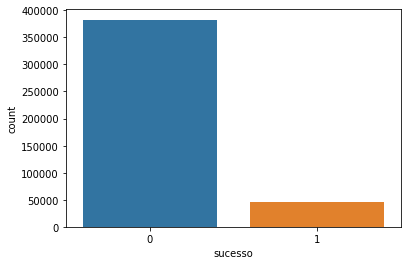

In [19]:
# Os dados são desbalanceados, muito mais instâncias com 0 do que com 1

sns.countplot(x='sucesso', data=dados);

Vamos tentar observar algumas relações entre as váriaveis

In [20]:
dados['caracteristica'].unique()[:20] # Para feature engineering seria interessante criar uma coluna (0 ou 1) para cada caracteristica

array(['Característica 1', 'Característica 6', 'Característica 7',
       'Característica 10', 'Característica 3', 'Característica 5',
       'Característica 2', 'Característica 5, Característica 8',
       'Característica 8', 'Característica 4', 'Característica 9',
       'Característica 9, Característica 3',
       'Característica 2, Característica 1',
       'Característica 3, Característica 4, Característica 8',
       'Característica 1, Característica 3, Característica 9',
       'Característica 3, Característica 10, Característica 4',
       'Característica 3, Característica 2',
       'Característica 6, Característica 4, Característica 8',
       'Característica 8, Característica 3',
       'Característica 1, Característica 8'], dtype=object)

In [21]:
dados['procedimentos'].unique()

array(['Nenhum', 'Todos acima', 'Tintura', 'Corte agressivo',
       'Exposição ao sol', 'Nenhum, Exposição ao sol',
       'Corte agressivo, Tintura', 'Nenhum, Corte agressivo',
       'Tintura, Corte agressivo', 'Exposição ao sol, Tintura',
       'Corte agressivo, Exposição ao sol',
       'Tintura, Corte agressivo, Exposição ao sol',
       'Tintura, Corte agressivo, Nenhum, Exposição ao sol',
       'Exposição ao sol, Corte agressivo',
       'Corte agressivo, Tintura, Exposição ao sol',
       'Exposição ao sol, Nenhum', 'Tintura, Exposição ao sol',
       'Corte agressivo, Exposição ao sol, Tintura',
       'Tintura, Nenhum, Corte agressivo, Exposição ao sol',
       'Nenhum, Exposição ao sol, Corte agressivo',
       'Corte agressivo, Nenhum, Exposição ao sol',
       'Tintura, Exposição ao sol, Nenhum',
       'Tintura, Corte agressivo, Nenhum', 'Corte agressivo, Nenhum',
       'Nenhum, Exposição ao sol, Tintura, Corte agressivo',
       'Nenhum, Corte agressivo, Exposição ao

In [22]:
dados['efeitos_desejados'].unique()

array(['Efeito 7', 'Efeito 1', None, ...,
       'Efeito 3, Efeito 1, Efeito 7, Efeito 5, Efeito 10',
       'Efeito 8, Efeito 2, Efeito 6, Efeito 10',
       'Efeito 8, Efeito 4, Efeito 10, Efeito 2, Efeito 7'], dtype=object)

Olhando para quantidades:

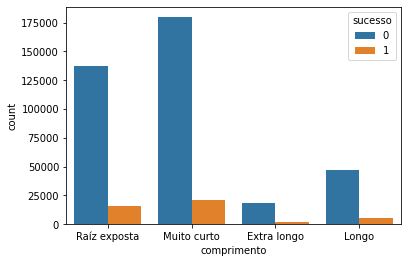

In [23]:
sns.countplot(x='comprimento', hue='sucesso', data=dados);

Olhando para as proporções:

In [24]:
def plot_proporcao(x, y='sucesso', df=df):
  x, y = x, y

  (dados
  .groupby(x)[y]
  .value_counts(normalize=True)
  .mul(100)
  .rename('percent')
  .reset_index()
  .pipe((sns.catplot,'data'), x=x,y='percent',hue=y,kind='bar'));

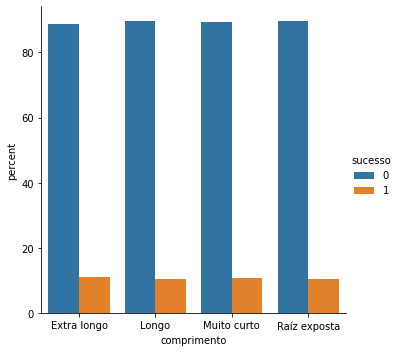

In [25]:
plot_proporcao(x='comprimento')

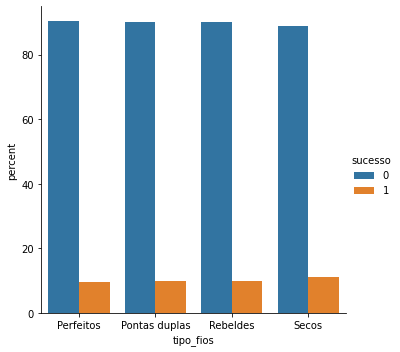

In [26]:
plot_proporcao(x='tipo_fios')

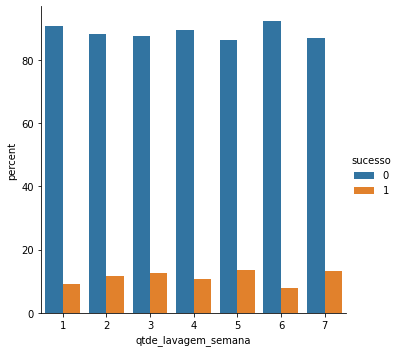

In [27]:
plot_proporcao(x='qtde_lavagem_semana', y='sucesso')

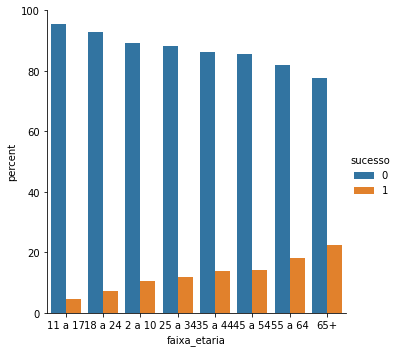

In [28]:
plot_proporcao(x='faixa_etaria')

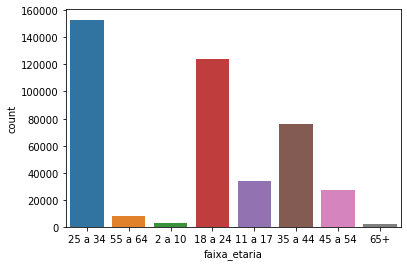

In [29]:
sns.countplot(x='faixa_etaria', data=df);

Pessoas com idades mais altas, parece que resultam em mais compras.

Aparentemente, a quantidade de lavagens por semana poder ter influência.

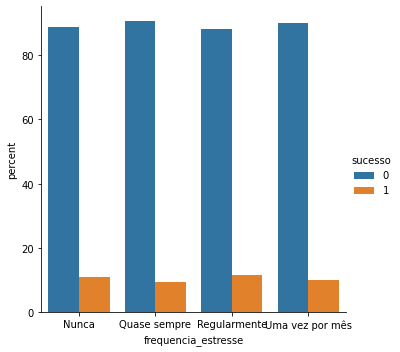

In [30]:
plot_proporcao(x='frequencia_estresse')

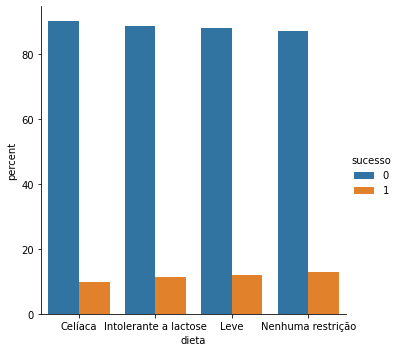

In [31]:
plot_proporcao(x='dieta')

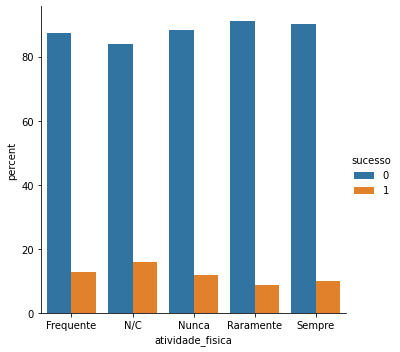

In [32]:
plot_proporcao('atividade_fisica')

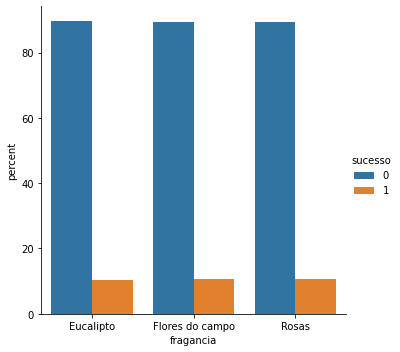

In [33]:
plot_proporcao('fragancia')

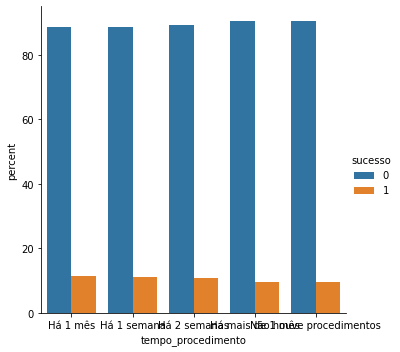

In [34]:
plot_proporcao('tempo_procedimento')

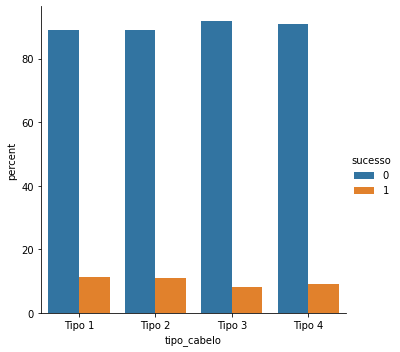

In [35]:
plot_proporcao(x='tipo_cabelo')

In [36]:
#dados['estado'].unique()

In [37]:
#dados['estado'].value_counts().head(30).plot(kind='barh',
#                                                       figsize=(20,10));

In [38]:
import plotly.express as px

grafico = px.treemap(dados, path=['tipo_cabelo', 'faixa_etaria'])
grafico.show()

In [39]:
grafico = px.treemap(dados, path=['sucesso', 'faixa_etaria'])
grafico.show()

In [40]:
grafico = px.treemap(dados, path=['qtde_lavagem_semana', 'tipo_cabelo'])
grafico.show()

In [41]:
grafico = px.parallel_categories(dados, dimensions=['comprimento', 'faixa_etaria'])
grafico.show()

In [42]:
grafico = px.parallel_categories(dados, dimensions=['tempo_procedimento', 'sucesso'])
grafico.show()

## Preprocessing data and feature engineering

Divisão entre previsores e classe

In [43]:
X = dados.copy().drop(columns=['sucesso'])
y = dados['sucesso'].values

X.head()

,qtde_lavagem_semana,tipo_cabelo,comprimento,tipo_fios,procedimentos,tempo_procedimento,dieta,atividade_fisica,frequencia_estresse,caracteristica,faixa_etaria,efeitos_desejados,fragancia
0,4,Tipo 2,Raíz exposta,Pontas duplas,Nenhum,Há 2 semanas,Celíaca,Frequente,Nunca,Característica 1,25 a 34,Efeito 7,Rosas
1,7,Tipo 4,Muito curto,Perfeitos,Todos acima,Há mais de 1 mês,Nenhuma restrição,Nunca,Nunca,Característica 6,55 a 64,Efeito 1,Eucalipto
2,2,Tipo 1,Extra longo,Rebeldes,Todos acima,Há mais de 1 mês,Nenhuma restrição,Raramente,Regularmente,Característica 7,2 a 10,Efeito 7,Rosas
3,5,Tipo 1,Extra longo,Rebeldes,Todos acima,Há mais de 1 mês,Celíaca,Raramente,Regularmente,Característica 7,25 a 34,Efeito 7,Rosas
4,4,Tipo 3,Muito curto,Rebeldes,Tintura,Há 1 semana,Celíaca,Sempre,Nunca,Característica 10,18 a 24,Efeito 7,Eucalipto


In [44]:
y

array([1, 0, 0, ..., 0, 0, 0])

### Missing values

In [45]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 427845 entries, 0 to 427949
Data columns (total 13 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   qtde_lavagem_semana  427845 non-null  int64 
 1   tipo_cabelo          427845 non-null  object
 2   comprimento          427845 non-null  object
 3   tipo_fios            427845 non-null  object
 4   procedimentos        427845 non-null  object
 5   tempo_procedimento   427845 non-null  object
 6   dieta                427845 non-null  object
 7   atividade_fisica     427845 non-null  object
 8   frequencia_estresse  427845 non-null  object
 9   caracteristica       427845 non-null  object
 10  faixa_etaria         427845 non-null  object
 11  efeitos_desejados    426866 non-null  object
 12  fragancia            427845 non-null  object
dtypes: int64(1), object(12)
memory usage: 61.8+ MB


In [46]:
X['efeitos_desejados'].fillna(value='nao_especificado', inplace=True)

In [47]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 427845 entries, 0 to 427949
Data columns (total 13 columns):
 #   Column               Non-Null Count   Dtype 
---  ------               --------------   ----- 
 0   qtde_lavagem_semana  427845 non-null  int64 
 1   tipo_cabelo          427845 non-null  object
 2   comprimento          427845 non-null  object
 3   tipo_fios            427845 non-null  object
 4   procedimentos        427845 non-null  object
 5   tempo_procedimento   427845 non-null  object
 6   dieta                427845 non-null  object
 7   atividade_fisica     427845 non-null  object
 8   frequencia_estresse  427845 non-null  object
 9   caracteristica       427845 non-null  object
 10  faixa_etaria         427845 non-null  object
 11  efeitos_desejados    427845 non-null  object
 12  fragancia            427845 non-null  object
dtypes: int64(1), object(12)
memory usage: 61.8+ MB


### Encoding data

In [48]:
def one_hot_column(column, dados=X):
  one_hot = pd.get_dummies(dados[column], prefix=column)
  dados.drop(columns=[column], inplace=True)
  dados = dados.join(one_hot)

  return dados

X = one_hot_column('qtde_lavagem_semana', X)
X = one_hot_column('tipo_cabelo', X)
X = one_hot_column('comprimento', X)
X = one_hot_column('tipo_fios', X)
X = one_hot_column('tempo_procedimento', X)
X = one_hot_column('dieta', X)
X = one_hot_column('atividade_fisica', X)
X = one_hot_column('frequencia_estresse', X)
X = one_hot_column('faixa_etaria', X)
X = one_hot_column('fragancia', X)

X.head()

,procedimentos,caracteristica,efeitos_desejados,qtde_lavagem_semana_1,qtde_lavagem_semana_2,qtde_lavagem_semana_3,qtde_lavagem_semana_4,qtde_lavagem_semana_5,qtde_lavagem_semana_6,qtde_lavagem_semana_7,...,faixa_etaria_18 a 24,faixa_etaria_2 a 10,faixa_etaria_25 a 34,faixa_etaria_35 a 44,faixa_etaria_45 a 54,faixa_etaria_55 a 64,faixa_etaria_65+,fragancia_Eucalipto,fragancia_Flores do campo,fragancia_Rosas
0,Nenhum,Característica 1,Efeito 7,0,0,0,1,0,0,0,...,0,0,1,0,0,0,0,0,0,1
1,Todos acima,Característica 6,Efeito 1,0,0,0,0,0,0,1,...,0,0,0,0,0,1,0,1,0,0
2,Todos acima,Característica 7,Efeito 7,0,1,0,0,0,0,0,...,0,1,0,0,0,0,0,0,0,1
3,Todos acima,Característica 7,Efeito 7,0,0,0,0,1,0,0,...,0,0,1,0,0,0,0,0,0,1
4,Tintura,Característica 10,Efeito 7,0,0,0,1,0,0,0,...,1,0,0,0,0,0,0,1,0,0


In [49]:
X.columns

Index(['procedimentos', 'caracteristica', 'efeitos_desejados',
       'qtde_lavagem_semana_1', 'qtde_lavagem_semana_2',
       'qtde_lavagem_semana_3', 'qtde_lavagem_semana_4',
       'qtde_lavagem_semana_5', 'qtde_lavagem_semana_6',
       'qtde_lavagem_semana_7', 'tipo_cabelo_Tipo 1', 'tipo_cabelo_Tipo 2',
       'tipo_cabelo_Tipo 3', 'tipo_cabelo_Tipo 4', 'comprimento_Extra longo',
       'comprimento_Longo', 'comprimento_Muito curto',
       'comprimento_Raíz exposta', 'tipo_fios_Perfeitos',
       'tipo_fios_Pontas duplas', 'tipo_fios_Rebeldes', 'tipo_fios_Secos',
       'tempo_procedimento_Há 1 mês', 'tempo_procedimento_Há 1 semana',
       'tempo_procedimento_Há 2 semanas',
       'tempo_procedimento_Há mais de 1 mês',
       'tempo_procedimento_Não houve procedimentos', 'dieta_Celíaca',
       'dieta_Intolerante a lactose', 'dieta_Leve', 'dieta_Nenhuma restrição',
       'atividade_fisica_Frequente', 'atividade_fisica_N/C',
       'atividade_fisica_Nunca', 'atividade_fisica_Rar

In [50]:
X['efeitos_desejados'].unique()

array(['Efeito 7', 'Efeito 1', 'nao_especificado', ...,
       'Efeito 3, Efeito 1, Efeito 7, Efeito 5, Efeito 10',
       'Efeito 8, Efeito 2, Efeito 6, Efeito 10',
       'Efeito 8, Efeito 4, Efeito 10, Efeito 2, Efeito 7'], dtype=object)

In [51]:
X.loc[(X['efeitos_desejados'].str.len() < 10)]['efeitos_desejados'].unique()

array(['Efeito 7', 'Efeito 1', 'Efeito 6', 'Efeito 5', 'Efeito 8',
       'Efeito 10', 'Efeito 3', 'Efeito 2', 'Efeito 4', 'N/C'],
      dtype=object)

In [52]:
def create_column(label, from_column, X):
  X[label] = X[from_column].apply(lambda x: 1 if label in x.split(',') else 0)

  return X

X = create_column('Efeito 1', 'efeitos_desejados', X)
X = create_column('Efeito 2', 'efeitos_desejados', X)
X = create_column('Efeito 3', 'efeitos_desejados', X)
X = create_column('Efeito 4', 'efeitos_desejados', X)
X = create_column('Efeito 5', 'efeitos_desejados', X)
X = create_column('Efeito 6', 'efeitos_desejados', X)
X = create_column('Efeito 7', 'efeitos_desejados', X)
X = create_column('Efeito 8', 'efeitos_desejados', X)
X = create_column('Efeito 10', 'efeitos_desejados', X)

X.head()

,procedimentos,caracteristica,efeitos_desejados,qtde_lavagem_semana_1,qtde_lavagem_semana_2,qtde_lavagem_semana_3,qtde_lavagem_semana_4,qtde_lavagem_semana_5,qtde_lavagem_semana_6,qtde_lavagem_semana_7,...,fragancia_Rosas,Efeito 1,Efeito 2,Efeito 3,Efeito 4,Efeito 5,Efeito 6,Efeito 7,Efeito 8,Efeito 10
0,Nenhum,Característica 1,Efeito 7,0,0,0,1,0,0,0,...,1,0,0,0,0,0,0,1,0,0
1,Todos acima,Característica 6,Efeito 1,0,0,0,0,0,0,1,...,0,1,0,0,0,0,0,0,0,0
2,Todos acima,Característica 7,Efeito 7,0,1,0,0,0,0,0,...,1,0,0,0,0,0,0,1,0,0
3,Todos acima,Característica 7,Efeito 7,0,0,0,0,1,0,0,...,1,0,0,0,0,0,0,1,0,0
4,Tintura,Característica 10,Efeito 7,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,1,0,0


In [53]:
X['caracteristica'].unique()

array(['Característica 1', 'Característica 6', 'Característica 7', ...,
       'Característica 8, Característica 4, Característica 6',
       'Característica 9, Característica 4, Característica 3, Característica 2, Característica 8',
       'Característica 1, Característica 5, Característica 2, Característica 6, Característica 10, Característica 4'],
      dtype=object)

In [54]:
X.loc[(X['caracteristica'].str.len() < 20)]['caracteristica'].unique()

array(['Característica 1', 'Característica 6', 'Característica 7',
       'Característica 10', 'Característica 3', 'Característica 5',
       'Característica 2', 'Característica 8', 'Característica 4',
       'Característica 9', 'N/C'], dtype=object)

In [55]:
X = create_column('Característica 1', 'caracteristica', X)
X = create_column('Característica 2', 'caracteristica', X)
X = create_column('Característica 3', 'caracteristica', X)
X = create_column('Característica 4', 'caracteristica', X)
X = create_column('Característica 5', 'caracteristica', X)
X = create_column('Característica 6', 'caracteristica', X)
X = create_column('Característica 7', 'caracteristica', X)
X = create_column('Característica 8', 'caracteristica', X)
X = create_column('Característica 9', 'caracteristica', X)
X = create_column('Característica 10', 'caracteristica', X)

X.head()

,procedimentos,caracteristica,efeitos_desejados,qtde_lavagem_semana_1,qtde_lavagem_semana_2,qtde_lavagem_semana_3,qtde_lavagem_semana_4,qtde_lavagem_semana_5,qtde_lavagem_semana_6,qtde_lavagem_semana_7,...,Característica 1,Característica 2,Característica 3,Característica 4,Característica 5,Característica 6,Característica 7,Característica 8,Característica 9,Característica 10
0,Nenhum,Característica 1,Efeito 7,0,0,0,1,0,0,0,...,1,0,0,0,0,0,0,0,0,0
1,Todos acima,Característica 6,Efeito 1,0,0,0,0,0,0,1,...,0,0,0,0,0,1,0,0,0,0
2,Todos acima,Característica 7,Efeito 7,0,1,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,0
3,Todos acima,Característica 7,Efeito 7,0,0,0,0,1,0,0,...,0,0,0,0,0,0,1,0,0,0
4,Tintura,Característica 10,Efeito 7,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,1


In [56]:
X['procedimentos'].unique() # Tintura, Corte agressivo, Exposição ao sol, Todos acima, Nenhum

array(['Nenhum', 'Todos acima', 'Tintura', 'Corte agressivo',
       'Exposição ao sol', 'Nenhum, Exposição ao sol',
       'Corte agressivo, Tintura', 'Nenhum, Corte agressivo',
       'Tintura, Corte agressivo', 'Exposição ao sol, Tintura',
       'Corte agressivo, Exposição ao sol',
       'Tintura, Corte agressivo, Exposição ao sol',
       'Tintura, Corte agressivo, Nenhum, Exposição ao sol',
       'Exposição ao sol, Corte agressivo',
       'Corte agressivo, Tintura, Exposição ao sol',
       'Exposição ao sol, Nenhum', 'Tintura, Exposição ao sol',
       'Corte agressivo, Exposição ao sol, Tintura',
       'Tintura, Nenhum, Corte agressivo, Exposição ao sol',
       'Nenhum, Exposição ao sol, Corte agressivo',
       'Corte agressivo, Nenhum, Exposição ao sol',
       'Tintura, Exposição ao sol, Nenhum',
       'Tintura, Corte agressivo, Nenhum', 'Corte agressivo, Nenhum',
       'Nenhum, Exposição ao sol, Tintura, Corte agressivo',
       'Nenhum, Corte agressivo, Exposição ao

In [57]:
def create_column_procedimento(label, from_column, X):
  X[label] = X[from_column].apply(lambda x: 1 if (label in x.split(',') or x == 'Todos acima') else 0)

  return X

X = create_column_procedimento('Tintura', 'procedimentos', X)
X = create_column_procedimento('Corte agressivo', 'procedimentos', X)
X = create_column_procedimento('Exposição ao sol', 'procedimentos', X)

X

,procedimentos,caracteristica,efeitos_desejados,qtde_lavagem_semana_1,qtde_lavagem_semana_2,qtde_lavagem_semana_3,qtde_lavagem_semana_4,qtde_lavagem_semana_5,qtde_lavagem_semana_6,qtde_lavagem_semana_7,...,Característica 4,Característica 5,Característica 6,Característica 7,Característica 8,Característica 9,Característica 10,Tintura,Corte agressivo,Exposição ao sol
0,Nenhum,Característica 1,Efeito 7,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,Todos acima,Característica 6,Efeito 1,0,0,0,0,0,0,1,...,0,0,1,0,0,0,0,1,1,1
2,Todos acima,Característica 7,Efeito 7,0,1,0,0,0,0,0,...,0,0,0,1,0,0,0,1,1,1
3,Todos acima,Característica 7,Efeito 7,0,0,0,0,1,0,0,...,0,0,0,1,0,0,0,1,1,1
4,Tintura,Característica 10,Efeito 7,0,0,0,1,0,0,0,...,0,0,0,0,0,0,1,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
427945,Nenhum,Característica 7,Efeito 7,0,0,0,1,0,0,0,...,0,0,0,1,0,0,0,0,0,0
427946,Tintura,Característica 9,"Efeito 7, Efeito 1, Efeito 5",1,0,0,0,0,0,0,...,0,0,0,0,0,1,0,1,0,0
427947,Nenhum,Característica 6,Efeito 1,0,0,0,0,0,0,1,...,0,0,1,0,0,0,0,0,0,0
427948,Todos acima,Característica 8,"Efeito 7, Efeito 1, Efeito 5, Efeito 8",0,0,0,1,0,0,0,...,0,0,0,0,1,0,0,1,1,1


In [58]:
X.drop(columns=['procedimentos', 'caracteristica', 'efeitos_desejados'],
       inplace=True)

X.head()

,qtde_lavagem_semana_1,qtde_lavagem_semana_2,qtde_lavagem_semana_3,qtde_lavagem_semana_4,qtde_lavagem_semana_5,qtde_lavagem_semana_6,qtde_lavagem_semana_7,tipo_cabelo_Tipo 1,tipo_cabelo_Tipo 2,tipo_cabelo_Tipo 3,...,Característica 4,Característica 5,Característica 6,Característica 7,Característica 8,Característica 9,Característica 10,Tintura,Corte agressivo,Exposição ao sol
0,0,0,0,1,0,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,1,0,0,0,...,0,0,1,0,0,0,0,1,1,1
2,0,1,0,0,0,0,0,1,0,0,...,0,0,0,1,0,0,0,1,1,1
3,0,0,0,0,1,0,0,1,0,0,...,0,0,0,1,0,0,0,1,1,1
4,0,0,0,1,0,0,0,0,0,1,...,0,0,0,0,0,0,1,1,0,0


Agora temos nossos dados OneHot encoded com 70 features, derivadas dos dados originais, os dados estão prontos para serem utilizados.

### Train-test split

In [59]:
X.shape, y.shape

((427845, 70), (427845,))

In [60]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1,
                                                     random_state = 42)

X_train.shape, y_train.shape, X_test.shape, y_test.shape

((385060, 70), (385060,), (42785, 70), (42785,))

## Modeling

In [61]:
X_train.shape, y_train.shape, X_test.shape, y_test.shape

((385060, 70), (385060,), (42785, 70), (42785,))

In [62]:
from sklearn.metrics import accuracy_score, roc_auc_score, confusion_matrix
from sklearn.metrics import recall_score, f1_score

## Function to evaluate preds

def evaluate_preds(y_true, y_pred):
  accuracy = accuracy_score(y_true, y_pred)
  roc_area = roc_auc_score(y_true, y_pred)
  cm = confusion_matrix(y_true, y_pred)
  prop = cm[0,0] / cm[1,0] ##### Prop é a proporção de disparos economizados para compras perdidas
  recall = recall_score(y_true, y_pred)
  f1 = f1_score(y_true, y_pred)
  
  return {"accuracy": accuracy,
          "roc_area": roc_area,
          "prop": prop,
          "recall": recall,
          "f1": f1}

### Baseline: Naive Bayes classifier

Esse algoritmo é um algoritmo probabílistico simples, o qual utiliza o teorema de Bayes, será usado como baseline para os resultados.

In [63]:
from sklearn.naive_bayes import GaussianNB

naive_model = GaussianNB()
naive_model.fit(X_train, y_train)

naive_preds = naive_model.predict(X_test)
naive_preds

array([0, 0, 0, ..., 0, 0, 0])

In [64]:
y_test

array([0, 0, 1, ..., 0, 0, 0])

In [65]:
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report
from yellowbrick.classifier import ConfusionMatrix

accuracy_score(naive_preds, y_test)

0.7755288068248218

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but GaussianNB was fitted with feature names



0.7755288068248218

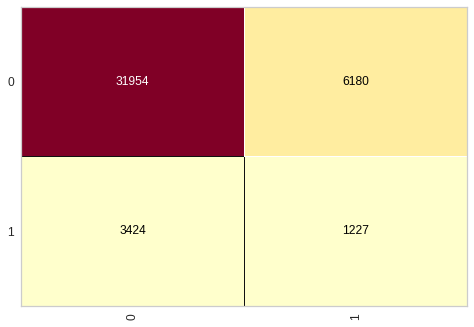

In [66]:
cm = ConfusionMatrix(naive_model)
cm.fit(X_train, y_train)
cm.score(X_test, y_test)

In [67]:
print(classification_report(y_test, naive_preds))

              precision    recall  f1-score   support

           0       0.90      0.84      0.87     38134
           1       0.17      0.26      0.20      4651

    accuracy                           0.78     42785
   macro avg       0.53      0.55      0.54     42785
weighted avg       0.82      0.78      0.80     42785



In [68]:
baseline_results = evaluate_preds(y_test, naive_preds)
baseline_results

{'accuracy': 0.7755288068248218,
 'f1': 0.20351633770111127,
 'prop': 9.332359813084112,
 'recall': 0.26381423349817246,
 'roc_area': 0.550877064826917}

Pensando nas métricas a serem analisadas, é interessante conseguirmos uma precisão boa para o algoritmo. Mas também devemos tentar minimizar principalmente o erro de quando um comprador que de fato compraria, seja classificado como não comprador. Ou seja, minimizar o recall da classe 1.

Então, por mais que a precisão do algoritmo seja 77%, o que é razoável, ele não pode ser considerado um bom algoritmo para o caso.

### Decision Tree

Árvores de decisão, são algoritmo simples que se baseiam em uma série de regras para tomarem decisões, possuem a topologia de uma árvore.

In [69]:
from sklearn.tree import DecisionTreeClassifier

tree_model = DecisionTreeClassifier(class_weight='balanced')
tree_model.fit(X_train, y_train)

tree_preds = tree_model.predict(X_test)
tree_preds

array([0, 0, 0, ..., 1, 0, 0])

In [70]:
y_test

array([0, 0, 1, ..., 0, 0, 0])

In [71]:
accuracy_score(tree_preds, y_test)

0.7648241206030151

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names



0.7648241206030151

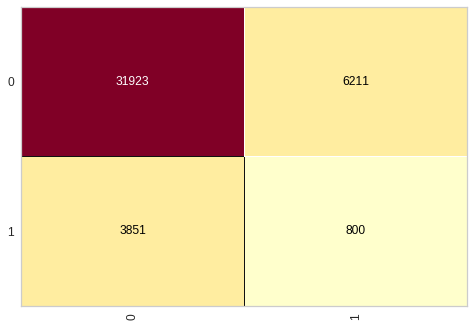

In [72]:
cm = ConfusionMatrix(tree_model)
cm.fit(X_train, y_train)
cm.score(X_test, y_test)

In [73]:
print(classification_report(y_test, tree_preds))

              precision    recall  f1-score   support

           0       0.89      0.84      0.86     38134
           1       0.11      0.17      0.14      4651

    accuracy                           0.76     42785
   macro avg       0.50      0.50      0.50     42785
weighted avg       0.81      0.76      0.78     42785



In [74]:
decision_t_results = evaluate_preds(y_test, tree_preds)
decision_t_results

{'accuracy': 0.7648241206030151,
 'f1': 0.13719773623735207,
 'prop': 8.289535185666061,
 'recall': 0.17200602021070738,
 'roc_area': 0.504566496757685}

### Random Forest

Random Forest é um algoritmo de ensemble, nele são usadas várias árvores de decisão e a decisão final tomada é decidida pela maioria.

In [75]:
from sklearn.ensemble import RandomForestClassifier

rm_model = RandomForestClassifier(class_weight='balanced')
rm_model.fit(X_train, y_train)

rm_preds = rm_model.predict(X_test)
rm_preds

array([0, 0, 0, ..., 1, 0, 0])

In [76]:
accuracy_score(rm_preds, y_test)

0.8458805656187917

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but RandomForestClassifier was fitted with feature names



0.8458805656187917

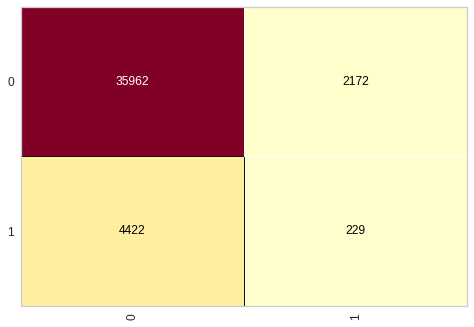

In [77]:
cm = ConfusionMatrix(rm_model)
cm.fit(X_train, y_train)
cm.score(X_test, y_test)

In [78]:
print(classification_report(y_test, rm_preds))

              precision    recall  f1-score   support

           0       0.89      0.94      0.92     38134
           1       0.10      0.05      0.06      4651

    accuracy                           0.85     42785
   macro avg       0.49      0.50      0.49     42785
weighted avg       0.80      0.85      0.82     42785



In [79]:
rm_results = evaluate_preds(y_test, rm_preds)
rm_results

{'accuracy': 0.8458805656187917,
 'f1': 0.06494611457742484,
 'prop': 8.13251922207146,
 'recall': 0.04923672328531498,
 'roc_area': 0.49613983853991456}

### Logistic Regression

A regressão logística é um algoritmo que calcula a probabilidade de sucesso, através de uma regressão linear com uma função sigmóide na saída, fazendo com que os valores estejam entre 1 e 0, esse valor é a probabilidade.

In [80]:
from sklearn.linear_model import LogisticRegression

lr_model = LogisticRegression(class_weight='balanced')
lr_model.fit(X_train, y_train)

lr_preds = lr_model.predict(X_test)
lr_preds

array([0, 1, 1, ..., 0, 0, 1])

In [81]:
accuracy_score(lr_preds, y_test)

0.5804838144209419

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:451: UserWarning:

X does not have valid feature names, but LogisticRegression was fitted with feature names



0.5804838144209419

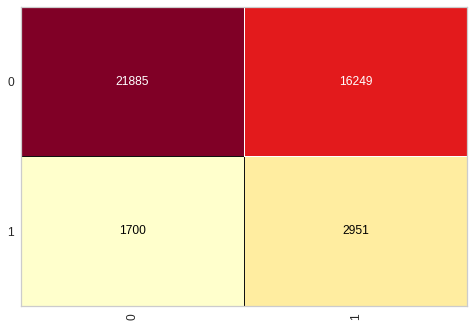

In [82]:
cm = ConfusionMatrix(lr_model)
cm.fit(X_train, y_train)
cm.score(X_test, y_test)

Os 43 mil disparos não realizados vale as 3300 compras não geradas pelos formulários?

In [83]:
print(classification_report(y_test, lr_preds))

              precision    recall  f1-score   support

           0       0.93      0.57      0.71     38134
           1       0.15      0.63      0.25      4651

    accuracy                           0.58     42785
   macro avg       0.54      0.60      0.48     42785
weighted avg       0.84      0.58      0.66     42785



In [84]:
from sklearn.metrics import roc_auc_score

roc_auc_score(y_test, lr_preds)

0.6041922582699215

In [85]:
lr_results = evaluate_preds(y_test, lr_preds)
lr_results

{'accuracy': 0.5804838144209419,
 'f1': 0.24745293698377424,
 'prop': 12.873529411764705,
 'recall': 0.6344872070522468,
 'roc_area': 0.6041922582699215}

A regressão logística apesar de ter a menor precisão, foi o algoritmo mais interessante até agora, pois teve um recall menor para a classe 1.

Uma mudança possível é alterar o THRESHOLD para um valor menor, para que o erro do tipo em que o formulário resulta em compra e sejam classificado com classe 0 seja menor.

In [86]:
THRESHOLD = 0.4

lr_prob = lr_model.predict_proba(X_test)
lr_prob

array([[0.51951957, 0.48048043],
       [0.48234892, 0.51765108],
       [0.39173648, 0.60826352],
       ...,
       [0.5818738 , 0.4181262 ],
       [0.52924153, 0.47075847],
       [0.43033312, 0.56966688]])

In [87]:
lr_preds = np.where(lr_prob[:,1] > THRESHOLD, 1, 0)

In [88]:
f1_score(y_test, lr_preds)

0.22512316642079774

In [89]:
recall_score(y_test, lr_preds)

0.8694904321651258

In [90]:
print(classification_report(y_test, lr_preds))

              precision    recall  f1-score   support

           0       0.95      0.29      0.44     38134
           1       0.13      0.87      0.23      4651

    accuracy                           0.35     42785
   macro avg       0.54      0.58      0.33     42785
weighted avg       0.86      0.35      0.42     42785



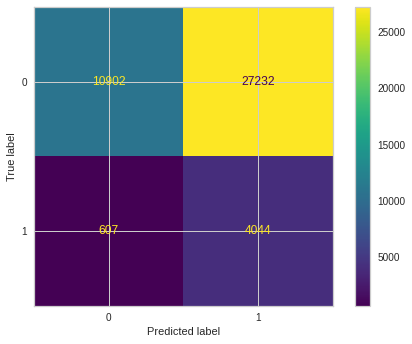

In [91]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm = confusion_matrix(y_test, lr_preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.show()

In [92]:
cm[0,0] / cm[1,0]

17.960461285008236

Proporção de disparos economizados para compras perdidas.

In [93]:
21862 / 1238

17.65912762520194

In [94]:
lr_th04_results = evaluate_preds(y_test, lr_preds)
lr_th04_results

{'accuracy': 0.34932803552646957,
 'f1': 0.22512316642079774,
 'prop': 17.960461285008236,
 'recall': 0.8694904321651258,
 'roc_area': 0.5776885212695351}

Em média, para cada 18 disparos economizados são perdidos uma compra.

Seria interessante criar uma métrica personalizada para esse caso, onde:

C seria o lucro real de cada compra, poderia ser uma média. \\
W seria o custo de cada disparo de whatsapp.

A métrica a ser otimizada (no caso, maximizada): TN * W - FN * C

Dessa forma o lucro será otimizado.

### Results so far

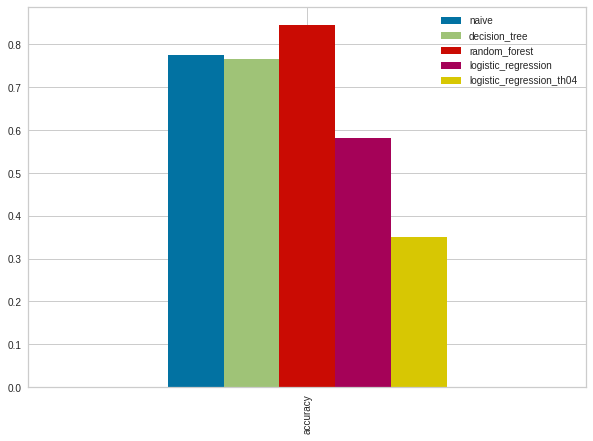

In [95]:
pd.DataFrame({'naive': baseline_results['accuracy'],
              'decision_tree': decision_t_results['accuracy'],
              'random_forest': rm_results['accuracy'],
              'logistic_regression': lr_results['accuracy'],
              'logistic_regression_th04': lr_th04_results['accuracy']}, index=['accuracy']).plot(figsize=(10,7), kind='bar')

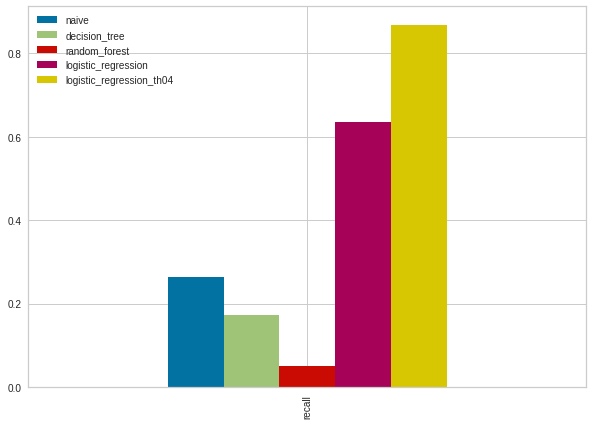

In [96]:
pd.DataFrame({'naive': baseline_results['recall'],
              'decision_tree': decision_t_results['recall'],
              'random_forest': rm_results['recall'],
              'logistic_regression': lr_results['recall'],
              'logistic_regression_th04': lr_th04_results['recall']}, index=['recall']).plot(figsize=(10,7), kind='bar')

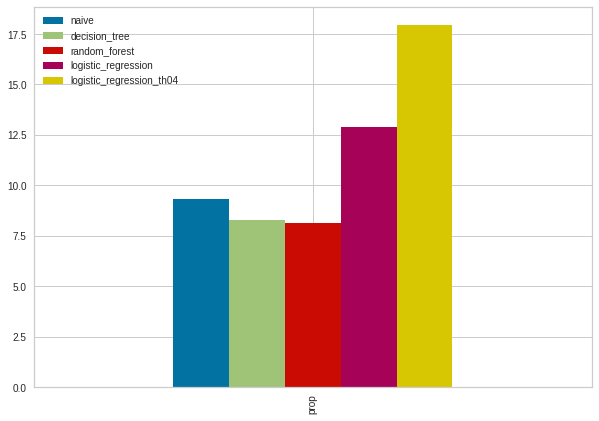

In [97]:
pd.DataFrame({'naive': baseline_results['prop'],
              'decision_tree': decision_t_results['prop'],
              'random_forest': rm_results['prop'],
              'logistic_regression': lr_results['prop'],
              'logistic_regression_th04': lr_th04_results['prop']}, index=['prop']).plot(figsize=(10,7), kind='bar')

Apesar dos modelos baseados em árvores possuirem as melhores precisão, para o problema apresentado eles são os que apresentam pior desempenho, pois deixam de mandar disparos de whatsapp para muitos compradores.

O algoritmo mais interessante até então foi a regressão logística.

### XGB

XGB e LGB são dois algoritmo de boosting, são baseados em random forest, porém a saída de uma árvore é utilizada como entrada de outro. A diferença entre os dois algoritmo é a forma com que a árvore cresce.

In [98]:
scale = 76363 / 9206

In [99]:
import xgboost as xgb
from xgboost import plot_importance, plot_tree

xgb_model = xgb.XGBClassifier(n_estimators=1000, scale_pos_weight=scale)
xgb_model.fit(X_train, y_train)

xgb_preds = xgb_model.predict(X_test)
xgb_preds

array([0, 1, 1, ..., 0, 0, 1])

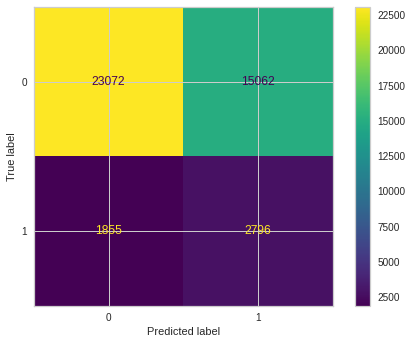

In [100]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm = confusion_matrix(y_test, xgb_preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.show()

In [101]:
xgb_results = evaluate_preds(y_test, xgb_preds)
xgb_results

{'accuracy': 0.6046044174360173,
 'f1': 0.24843395974943358,
 'prop': 12.437735849056605,
 'recall': 0.6011610406364223,
 'roc_area': 0.6030927141609761}

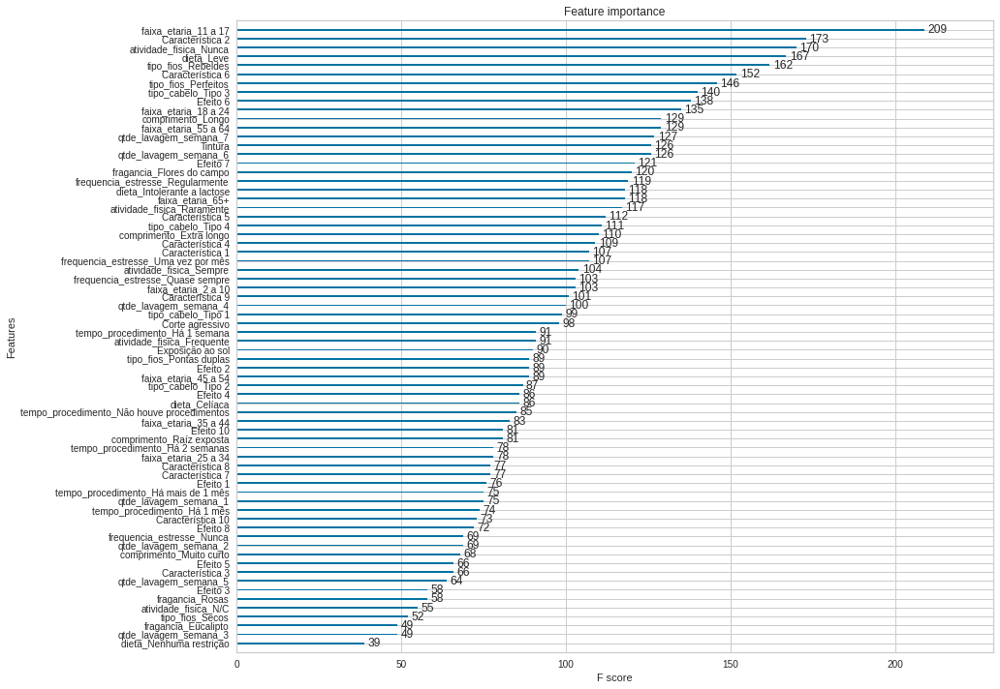

In [102]:
plt.rcParams["figure.figsize"] = (14, 12)
plot_importance(xgb_model, height=0.2)

### LGB

In [103]:
import lightgbm as lgb

lgb_model = lgb.LGBMClassifier(n_estimators=1000, scale_pos_weight=scale)
lgb_model.fit(X_train, y_train)

lgb_preds = lgb_model.predict(X_test)
lgb_preds

array([0, 1, 1, ..., 0, 0, 1])

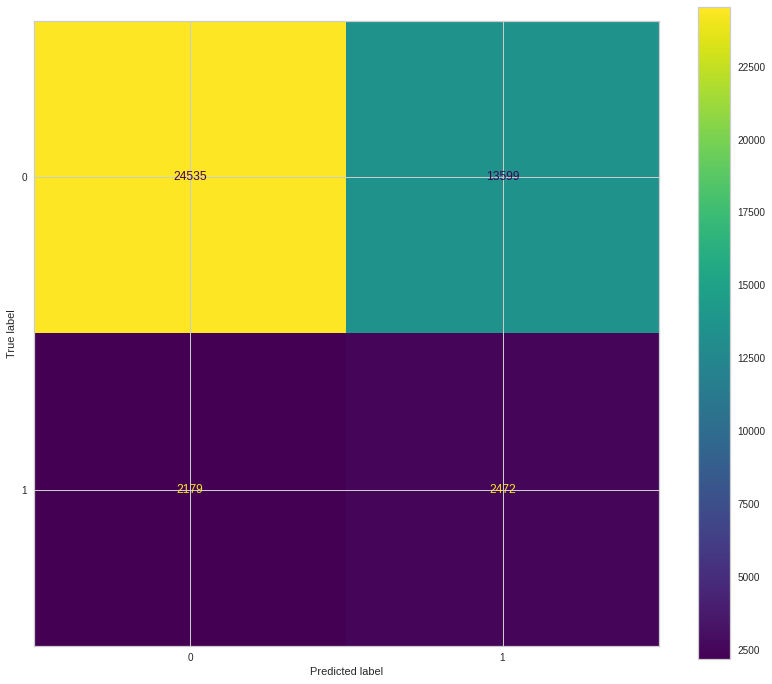

In [104]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm = confusion_matrix(y_test, lgb_preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.show()

In [105]:
lgb_results = evaluate_preds(y_test, lgb_preds)
lgb_results

{'accuracy': 0.6312258969264929,
 'f1': 0.23858700897596757,
 'prop': 11.259752179899037,
 'recall': 0.5314986024510858,
 'roc_area': 0.5874438520201095}

### SVM

In [106]:
# from sklearn.svm import SVC

# svm_model = SVC(kernel='linear', random_state=1)
# svm_model.fit(X_train, y_train)

# svm_preds = svm_model.predict(X_test)
# svm_preds

In [107]:
# from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# cm = confusion_matrix(y_test, svm_preds)
# disp = ConfusionMatrixDisplay(confusion_matrix=cm)
# disp.plot()
# plt.show()

In [108]:
# svm_results = evaluate_preds(y_test, svm_preds)
# svm_results

### KNN 

Este algoritmo consiste em pegar as K instâncias(registros) mais próximos do registro que está sendo predizido, e atribuir a classe que possui mais registros dessas K instâncias.

In [109]:
from sklearn.utils import class_weight
from pandas.core.dtypes.common import classes_and_not_datetimelike
from sklearn.neighbors import KNeighborsClassifier

knn_model = KNeighborsClassifier(n_neighbors=7)
knn_model.fit(X_train, y_train)

knn_preds = knn_model.predict(X_test)
knn_preds

array([0, 0, 0, ..., 0, 0, 0])

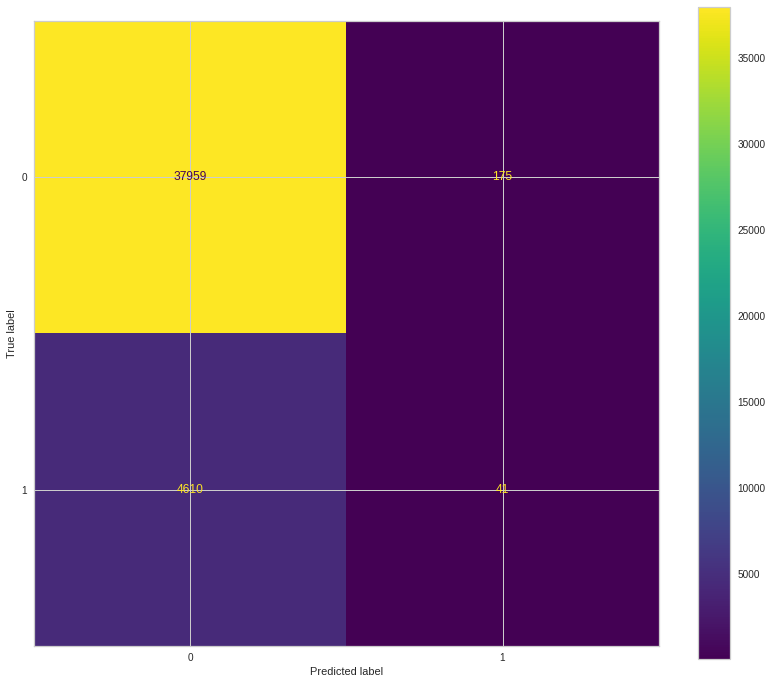

In [110]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm = confusion_matrix(y_test, knn_preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.show()

In [111]:
knn_results = evaluate_preds(y_test, knn_preds)
knn_results

{'accuracy': 0.8881617389271941,
 'f1': 0.0168481610848572,
 'prop': 8.23405639913232,
 'recall': 0.008815308535798753,
 'roc_area': 0.50211311396266}

### Deep Learning

In [112]:
import tensorflow as tf

tf.random.set_seed(42)

fc_model = tf.keras.Sequential([
                                tf.keras.layers.Dense(128, activation='relu'),
                                tf.keras.layers.Dense(64, activation='relu'),
                                tf.keras.layers.Dense(1, activation='sigmoid')
])

fc_model.compile(loss = 'binary_crossentropy',
                 optimizer = tf.keras.optimizers.Adam(0.005),
                 metrics = ['accuracy', tf.keras.metrics.Recall(name='recall')])

history = fc_model.fit(X_train, y_train, epochs = 50)

Epoch 1/50
12034/12034 [==============================] - 46s 4ms/step - loss: 0.3288 - accuracy: 0.8946 - recall: 9.8561e-05
Epoch 2/50
12034/12034 [==============================] - 41s 3ms/step - loss: 0.3271 - accuracy: 0.8946 - recall: 7.3921e-05
Epoch 3/50
12034/12034 [==============================] - 42s 4ms/step - loss: 0.3268 - accuracy: 0.8946 - recall: 0.0000e+00
Epoch 4/50
12034/12034 [==============================] - 41s 3ms/step - loss: 0.3267 - accuracy: 0.8946 - recall: 9.8561e-05
Epoch 5/50
12034/12034 [==============================] - 42s 4ms/step - loss: 0.3264 - accuracy: 0.8946 - recall: 1.9712e-04
Epoch 6/50
12034/12034 [==============================] - 42s 4ms/step - loss: 0.3263 - accuracy: 0.8946 - recall: 3.6960e-04
Epoch 7/50
12034/12034 [==============================] - 41s 3ms/step - loss: 0.3260 - accuracy: 0.8946 - recall: 1.7248e-04
Epoch 8/50
12034/12034 [==============================] - 42s 4ms/step - loss: 0.3257 - accuracy: 0.8946 - recall: 3.4

In [113]:
THRESHOLD = 0.15

fc_model_preds = fc_model.predict(X_test)
fc_model_preds = np.where(tf.squeeze(fc_model_preds, axis=1).numpy() > THRESHOLD, 1, 0)
fc_model_preds

array([0, 0, 0, ..., 0, 0, 1])

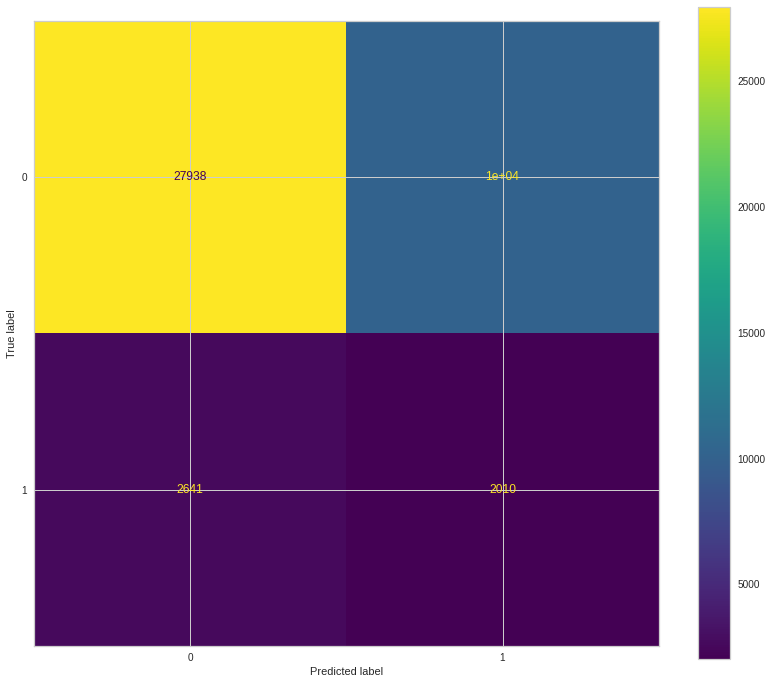

In [114]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm = confusion_matrix(y_test, fc_model_preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.show()

In [115]:
fc_model_results = evaluate_preds(y_test, fc_model_preds)
fc_model_results

{'accuracy': 0.6999649409839898,
 'f1': 0.23847659725929882,
 'prop': 10.578568723968194,
 'recall': 0.4321651257794023,
 'roc_area': 0.5823960888770091}

### Results so far

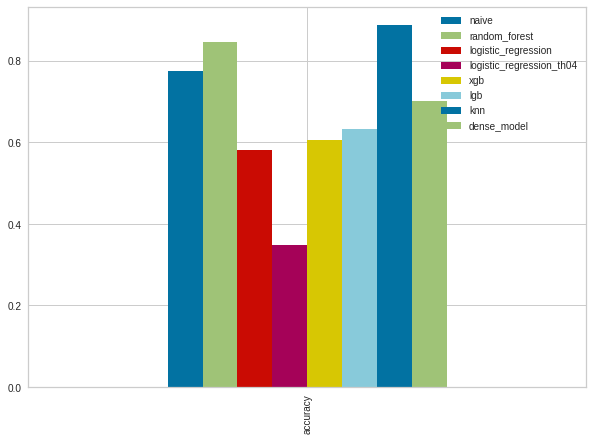

In [116]:
pd.DataFrame({'naive': baseline_results['accuracy'],
              'random_forest': rm_results['accuracy'],
              'logistic_regression': lr_results['accuracy'],
              'logistic_regression_th04': lr_th04_results['accuracy'],             
              'xgb' : xgb_results['accuracy'],
              'lgb' : lgb_results['accuracy'],
              'knn' : knn_results['accuracy'],
              'dense_model' : fc_model_results['accuracy']},
              index=['accuracy']).plot(figsize=(10,7), kind='bar');

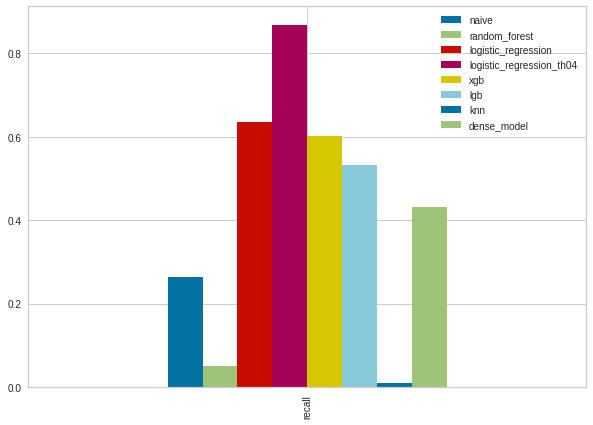

In [117]:
pd.DataFrame({'naive': baseline_results['recall'],
              'random_forest': rm_results['recall'],
              'logistic_regression': lr_results['recall'],
              'logistic_regression_th04': lr_th04_results['recall'],
              'xgb' : xgb_results['recall'],
              'lgb' : lgb_results['recall'],
              'knn' : knn_results['recall'],
              'dense_model' : fc_model_results['recall']},
              index=['recall']).plot(figsize=(10,7), kind='bar');

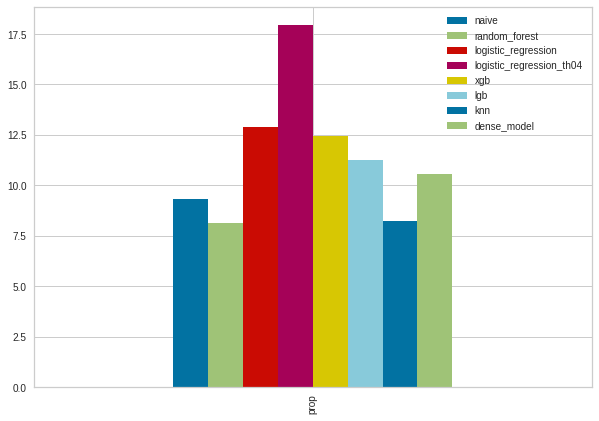

In [118]:
pd.DataFrame({'naive': baseline_results['prop'],
              'random_forest': rm_results['prop'],
              'logistic_regression': lr_results['prop'],
              'logistic_regression_th04': lr_th04_results['prop'],
              'xgb' : xgb_results['prop'],
              'lgb' : lgb_results['prop'],
              'knn' : knn_results['prop'],
              'dense_model' : fc_model_results['prop']},
              index=['prop']).plot(figsize=(10,7), kind='bar');

In [119]:
baseline_results

{'accuracy': 0.7755288068248218,
 'f1': 0.20351633770111127,
 'prop': 9.332359813084112,
 'recall': 0.26381423349817246,
 'roc_area': 0.550877064826917}

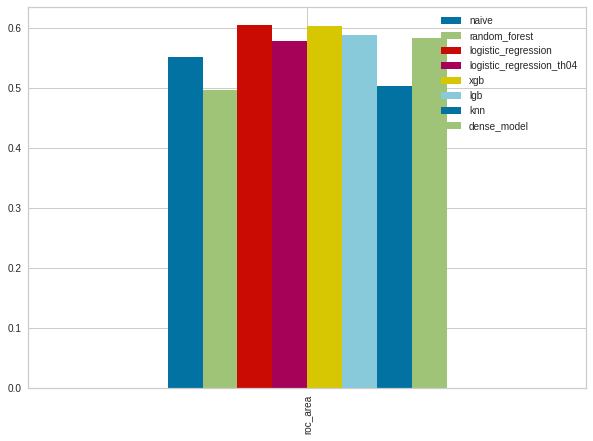

In [120]:
pd.DataFrame({'naive': baseline_results['roc_area'],
              'random_forest': rm_results['roc_area'],
              'logistic_regression': lr_results['roc_area'],
              'logistic_regression_th04': lr_th04_results['roc_area'],
              'xgb' : xgb_results['roc_area'],
              'lgb' : lgb_results['roc_area'],
              'knn' : knn_results['roc_area'],
              'dense_model' : fc_model_results['roc_area']},
              index=['roc_area']).plot(figsize=(10,7), kind='bar');

Dificuldade em encontrar um bom modelo e que traduza a necessidade do negócio.

Classes muito desbalanceadas, e uma necessidade grande de classificação correta da que possui menos registros.

Revisão das features?

Irei usar o melhor modelo até então, para conduzir mais experimentos fazendo o tuning do hiperparametros e validação cruzada dos dados. Modelos:
* Regressão Logística

## Hyperparameter tuning

In [112]:
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold

In [113]:
X.shape, y.shape

((427845, 70), (427845,))

**Logistic Regression**

In [114]:

from sklearn.linear_model import LogisticRegression

parametros = {#tol': [0.0001, 0.00001, 0.000001],
              'C': [1.0, 10, 0.1],
              'solver': ['newton-cg', 'lbfgs'],
              'penalty': ['l2']} #'none', 'l1', 

model = LogisticRegression(class_weight='balanced')

cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)
grid_search = GridSearchCV(estimator=model, cv=cv,
                           param_grid=parametros, n_jobs = -1, verbose=1,
                           scoring='recall')
grid_result = grid_search.fit(X_train, y_train)

print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))
means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, stdev, param))

Fitting 30 folds for each of 6 candidates, totalling 180 fits


/usr/local/lib/python3.7/dist-packages/joblib/externals/loky/process_executor.py:705: UserWarning:

A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.



Best: 0.620417 using {'C': 10, 'penalty': 'l2', 'solver': 'lbfgs'}
0.620359 (0.008192) with: {'C': 1.0, 'penalty': 'l2', 'solver': 'newton-cg'}
0.620310 (0.008216) with: {'C': 1.0, 'penalty': 'l2', 'solver': 'lbfgs'}
0.620400 (0.008218) with: {'C': 10, 'penalty': 'l2', 'solver': 'newton-cg'}
0.620417 (0.008196) with: {'C': 10, 'penalty': 'l2', 'solver': 'lbfgs'}
0.620236 (0.008127) with: {'C': 0.1, 'penalty': 'l2', 'solver': 'newton-cg'}
0.620228 (0.008119) with: {'C': 0.1, 'penalty': 'l2', 'solver': 'lbfgs'}


In [120]:
preds = np.where(grid_result.predict_proba(X_test)[:,1] > 0.4, 1, 0)
preds

array([1, 1, 1, ..., 1, 1, 1])

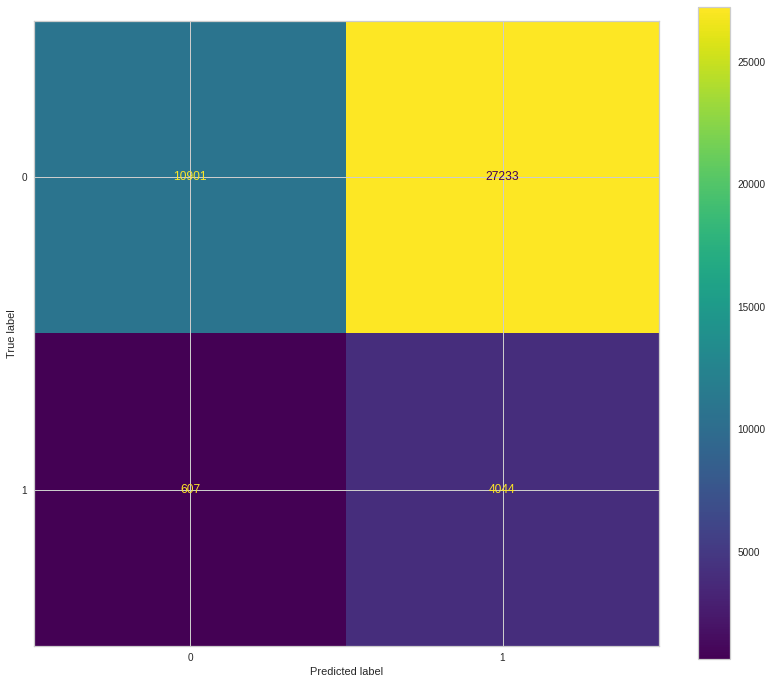

In [121]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm = confusion_matrix(y_test, preds)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.show()

In [124]:
results_lr = evaluate_preds(y_test, preds)
results_lr

{'accuracy': 0.34930466284912937,
 'f1': 0.22511690046760185,
 'prop': 17.958813838550245,
 'recall': 0.8694904321651258,
 'roc_area': 0.577675409610648}

Melhor modelo encontrado

## Saving and load model

In [125]:
import joblib

joblib.dump(grid_search, 'logistic_regression_th04.pkl')

['logistic_regression_th04.pkl']

In [127]:
model = joblib.load("logistic_regression_th04.pkl")

preds = np.where(grid_result.predict_proba(X_test)[:,1] > 0.4, 1, 0)
evaluate_preds(y_test, preds)

{'accuracy': 0.34930466284912937,
 'f1': 0.22511690046760185,
 'prop': 17.958813838550245,
 'recall': 0.8694904321651258,
 'roc_area': 0.577675409610648}